# Let's do Cartpole gym:)
https://pytorch.org/tutorials/intermediate/reinforcement_q_learning.html

https://stackoverflow.com/questions/50107530/how-to-render-openai-gym-in-google-colab

# Prerequites
It is needed for displaying the openAI in google colab

In [0]:
!apt-get install -y xvfb python-opengl > /dev/null 2>&1
!apt-get install x11-utils > /dev/null 2>&1
!pip install gym pyvirtualdisplay > /dev/null 2>&1
!pip install pyglet==v1.3.2

# Import Packages/Basic settings for Cartpole

In [0]:
# Basic packages
import gym
import numpy as np
import matplotlib.pyplot as plt
import math
import random
import matplotlib
from collections import namedtuple
from itertools import count
from PIL import Image
# Pytorch packages
import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
import torchvision.transforms as T
# Display packages
from IPython import display as ipythondisplay
from pyvirtualdisplay import Display
import matplotlib.animation
from IPython.display import HTML
# Driver Package
import os
from google.colab import drive

In [0]:
drive.mount('/content/gdrive', force_remount=True)
!pwd
os.chdir('gdrive/Shared drives/Reinforcement Learning/Cartpole')
!pwd
!ls

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/gdrive
/content
/content/gdrive/Shared drives/Reinforcement Learning/Cartpole
 Cartpole_keras.ipynb
'Cartpole_Moving_Average_Reward(Episode_403).PNG'
 Cartpole_pytorch.ipynb
'Cartpole_Reward(Episode_403).PNG'
 noise.avi
 save


In [0]:
display = Display(visible=0, size=(400, 300))
display.start()

<Display cmd_param=['Xvfb', '-br', '-nolisten', 'tcp', '-screen', '0', '400x300x24', ':1001'] cmd=['Xvfb', '-br', '-nolisten', 'tcp', '-screen', '0', '400x300x24', ':1001'] oserror=None return_code=None stdout="None" stderr="None" timeout_happened=False>

In [0]:
env = gym.make('CartPole-v0').unwrapped
# gpu enabled
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

## Replay Memory

We’ll be using experience replay memory for training our DQN. It stores the transitions that the agent observes, allowing us to reuse this data later. By sampling from it randomly, the transitions that build up a batch are decorrelated. It has been shown that this greatly stabilizes and improves the DQN training procedure.

For this, we’re going to need two classses:

- Transition - a named tuple representing a single transition in our environment. It essentially maps (state, action) pairs to their (next_state, reward) result, with the state being the screen difference image as described later on. <br>
- ReplayMemory - a cyclic buffer of bounded size that holds the transitions observed recently. It also implements a .sample() method for selecting a random batch of transitions for training.

In [0]:
Transition = namedtuple('Transition',('state', 'action', 'next_state', 'reward'))

class ReplayMemory(object):
    def __init__(self, capacity):
        self.capacity = capacity
        self.memory = []
        self.position = 0
    def push(self, *args):
        # Saves a transition
        if len(self.memory) < self.capacity:
            self.memory.append(None)
        self.memory[self.position] = Transition(*args)
        self.position = (self.position + 1) % self.capacity
    def sample(self, batch_size):
        return random.sample(self.memory, batch_size)
    def __len__(self):
        return len(self.memory)

## DQN algorithm

Our environment is deterministic, so all equations presented here are also formulated deterministically for the sake of simplicity. In the reinforcement learning literature, they would also contain expectations over stochastic transitions in the environment.

In [0]:
class DQN(nn.Module):
    def __init__(self, h, w, outputs):
        super(DQN, self).__init__()
        self.conv1 = nn.Conv2d(3, 16, kernel_size=5, stride=2)
        self.bn1 = nn.BatchNorm2d(16)
        self.conv2 = nn.Conv2d(16, 32, kernel_size=5, stride=2)
        self.bn2 = nn.BatchNorm2d(32)
        self.conv3 = nn.Conv2d(32, 32, kernel_size=5, stride=2)
        self.bn3 = nn.BatchNorm2d(32)
        # Number of Linear input connections depends on output of conv2d layers
        # and therefore the input image size, so compute it.
        def conv2d_size_out(size, kernel_size = 5, stride = 2):
            return (size - (kernel_size - 1) - 1) // stride  + 1
        convw = conv2d_size_out(conv2d_size_out(conv2d_size_out(w)))
        convh = conv2d_size_out(conv2d_size_out(conv2d_size_out(h)))
        linear_input_size = convw * convh * 32
        self.head = nn.Linear(linear_input_size, outputs)
    # Called with either one element to determine next action, or a batch
    # during optimization. Returns tensor([[left0exp,right0exp]...]).
    def forward(self, x):
        x = F.relu(self.bn1(self.conv1(x)))
        x = F.relu(self.bn2(self.conv2(x)))
        x = F.relu(self.bn3(self.conv3(x)))
        return self.head(x.view(x.size(0), -1))

In [0]:
resize = T.Compose([T.ToPILImage(),
                    T.Resize(40, interpolation=Image.CUBIC),
                    T.ToTensor()])

def display():
    # Returned screen requested by gym is 400x600x3, but is sometimes larger
    # such as 800x1200x3. Transpose it into torch order (CHW).
    screen = env.render(mode='rgb_array').transpose((2, 0, 1))
    # Cart is in the lower half, so strip off the top and bottom of the screen
    _, screen_height, screen_width = screen.shape
    screen = screen[:, int(screen_height*0.4):int(screen_height * 0.8)]
    view_width = int(screen_width * 0.6)
    world_width = env.x_threshold * 2
    scale = screen_width / world_width
    cart_location = int(env.state[0] * scale + screen_width / 2.0)  # MIDDLE OF CART
    if cart_location < view_width // 2:
        slice_range = slice(view_width)
    elif cart_location > (screen_width - view_width // 2):
        slice_range = slice(-view_width, None)
    else:
        slice_range = slice(cart_location - view_width // 2,
                            cart_location + view_width // 2)
    # Strip off the edges, so that we have a square image centered on a cart
    screen = screen[:, :, slice_range]
    # Convert to float, rescale, convert to torch tensor
    screen = np.ascontiguousarray(screen, dtype=np.float32) / 255
    screen = torch.from_numpy(screen)
    # Resize, and add a batch dimension (BCHW)
    return resize(screen).unsqueeze(0).to(device)
env.reset()

array([-0.01372138, -0.01056085, -0.0251237 ,  0.01754154])

# Hyperparamter Tuning
We try to change the parameter to optimize our agent and the evaulation study can be found below.

In [0]:
batch_size = 128
gamma = 0.999
episode_start = 0.9
episode_end = 0.05
episode_decay = 200
target_update = 10

# Display our model
Get screen size so that we can initialize layers correctly based on shape returned from AI gym. Typical dimensions at this point are close to 3x40x90 which is the result of a clamped and down-scaled render buffer in display()

In [0]:
init_screen = display()
_, _, screen_height, screen_width = init_screen.shape

# Get number of actions from gym action space
n_actions = env.action_space.n

policy_net = DQN(screen_height, screen_width, n_actions).to(device)
target_net = DQN(screen_height, screen_width, n_actions).to(device)
target_net.load_state_dict(policy_net.state_dict())
target_net.eval()

optimizer = optim.RMSprop(policy_net.parameters())
memory = ReplayMemory(10000)

steps_done = 0

def select_action(state):
    global steps_done
    sample = random.random()
    eps_threshold = episode_end + (episode_start - episode_end) * \
        math.exp(-1. * steps_done / episode_decay)
    steps_done += 1
    if sample > eps_threshold:
        with torch.no_grad():
            # t.max(1) will return largest column value of each row.
            # second column on max result is index of where max element was
            # found, so we pick action with the larger expected reward.
            return policy_net(state).max(1)[1].view(1, 1)
    else:
        return torch.tensor([[random.randrange(n_actions)]], device=device, dtype=torch.long)

# Optimize our model

In [0]:
def optimize_model():
    if len(memory) < batch_size:
        return
    transitions = memory.sample(batch_size)
    # Transpose the batch (see https://stackoverflow.com/a/19343/3343043 for detailed explanation). This converts batch-array of Transitions to Transition of batch-arrays.
    batch = Transition(*zip(*transitions))
    # Compute a mask of non-final states and concatenate the batch elements
    # (a final state would've been the one after which simulation ended)
    non_final_mask = torch.tensor(tuple(map(lambda s: s is not None, batch.next_state)), device=device, dtype=torch.torch.bool)
    non_final_next_states = torch.cat([s for s in batch.next_state if s is not None])
    state_batch = torch.cat(batch.state)
    action_batch = torch.cat(batch.action)
    reward_batch = torch.cat(batch.reward)
    # Compute Q(s_t, a) - the model computes Q(s_t), then we select the columns of actions taken. These are the actions which would've been taken for each batch state according to policy_net
    state_action_values = policy_net(state_batch).gather(1, action_batch)
    # Compute V(s_{t+1}) for all next states.
    # Expected values of actions for non_final_next_states are computed based
    # on the "older" target_net; selecting their best reward with max(1)[0].
    # This is merged based on the mask, such that we'll have either the expected
    # state value or 0 in case the state was final.
    next_state_values = torch.zeros(batch_size, device=device)
    next_state_values[non_final_mask] = target_net(non_final_next_states).max(1)[0].detach()
    # Compute the expected Q values
    expected_state_action_values = (next_state_values * gamma) + reward_batch
    # Compute Huber loss
    loss = F.smooth_l1_loss(state_action_values, expected_state_action_values.unsqueeze(1))
    # Optimize the model
    optimizer.zero_grad()
    loss.backward()
    for param in policy_net.parameters():
        param.grad.data.clamp_(-1, 1)
    optimizer.step()

# Run our model
Let's run for 403 episodes (took less than 1 hour in  Google Colab) and get some results!

In [0]:
num_episodes = 450
t_reward, frames, episode_durations = [],[],[]
for i_episode in range(num_episodes):
    # Initialize the environment and state
    env.reset()
    last_screen = display()
    current_screen = display()
    state = current_screen - last_screen
    for t in count():
        # Select and perform an action
        frames.append(env.render(mode = 'rgb_array'))
        action = select_action(state)
        _, reward, done, _ = env.step(action.item())
        reward = torch.tensor([reward], device=device)
        # Observe new state
        last_screen = current_screen
        current_screen = display()
        if not done:
            next_state = current_screen - last_screen
        else:
            next_state = None
        # Store the transition in memory
        memory.push(state, action, next_state, reward)       
        # Move to the next state
        state = next_state  
        # Perform one step of the optimization (on the target network)
        optimize_model()
        if done:
            episode_durations.append(t + 1)
            break
    # Update the target network, copying all weights and biases in DQN
    if i_episode % target_update == 0:
        target_net.load_state_dict(policy_net.state_dict())
    durations_t = torch.tensor(episode_durations, dtype=torch.float)
    r = durations_t.numpy()
    # Print the rewards
    print("Episode: ",i_episode+1, "|| Reward :", r[-1])
# Print all the rewards for all episodes    
print("All the rewards:", r[:])
print('Episode reached terminal state')
env.render()
env.close()

Episode:  1 || Reward : 28.0
Episode:  2 || Reward : 23.0
Episode:  3 || Reward : 13.0
Episode:  4 || Reward : 27.0
Episode:  5 || Reward : 15.0
Episode:  6 || Reward : 12.0
Episode:  7 || Reward : 19.0
Episode:  8 || Reward : 25.0
Episode:  9 || Reward : 33.0
Episode:  10 || Reward : 20.0
Episode:  11 || Reward : 24.0
Episode:  12 || Reward : 10.0
Episode:  13 || Reward : 15.0
Episode:  14 || Reward : 38.0
Episode:  15 || Reward : 17.0
Episode:  16 || Reward : 29.0
Episode:  17 || Reward : 19.0
Episode:  18 || Reward : 11.0
Episode:  19 || Reward : 26.0
Episode:  20 || Reward : 36.0
Episode:  21 || Reward : 13.0
Episode:  22 || Reward : 30.0
Episode:  23 || Reward : 28.0
Episode:  24 || Reward : 10.0
Episode:  25 || Reward : 14.0
Episode:  26 || Reward : 10.0
Episode:  27 || Reward : 34.0
Episode:  28 || Reward : 12.0
Episode:  29 || Reward : 20.0
Episode:  30 || Reward : 11.0
Episode:  31 || Reward : 16.0
Episode:  32 || Reward : 22.0
Episode:  33 || Reward : 13.0
Episode:  34 || Rew

# Plotting the Rewards after each episode

<Figure size 432x288 with 0 Axes>

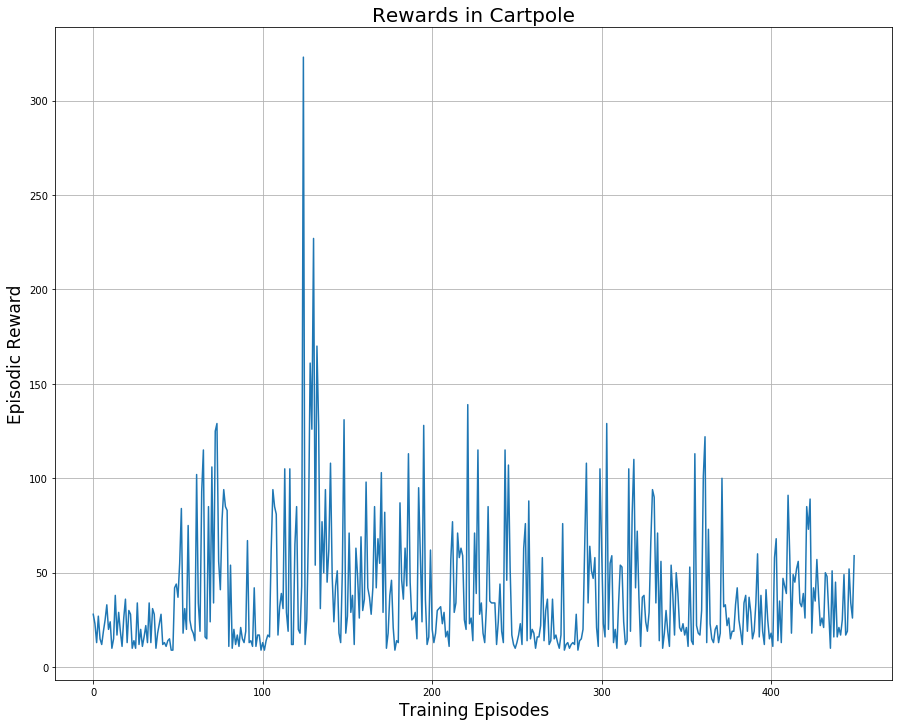

In [0]:
plt.figure()
durations_t = torch.tensor(episode_durations, dtype=torch.float)
plt.figure(figsize=[15, 12])
plt.title('Rewards in Cartpole',fontsize=20)
plt.xlabel('Training Episodes',fontsize=17)
plt.ylabel('Episodic Reward',fontsize=17)
plt.grid(True)
d_t = durations_t.numpy()
plt.plot(d_t)
plt.savefig('./Cartpole_Reward.PNG', dpi=600)
plt.show()

# Moving Average Reward plotting

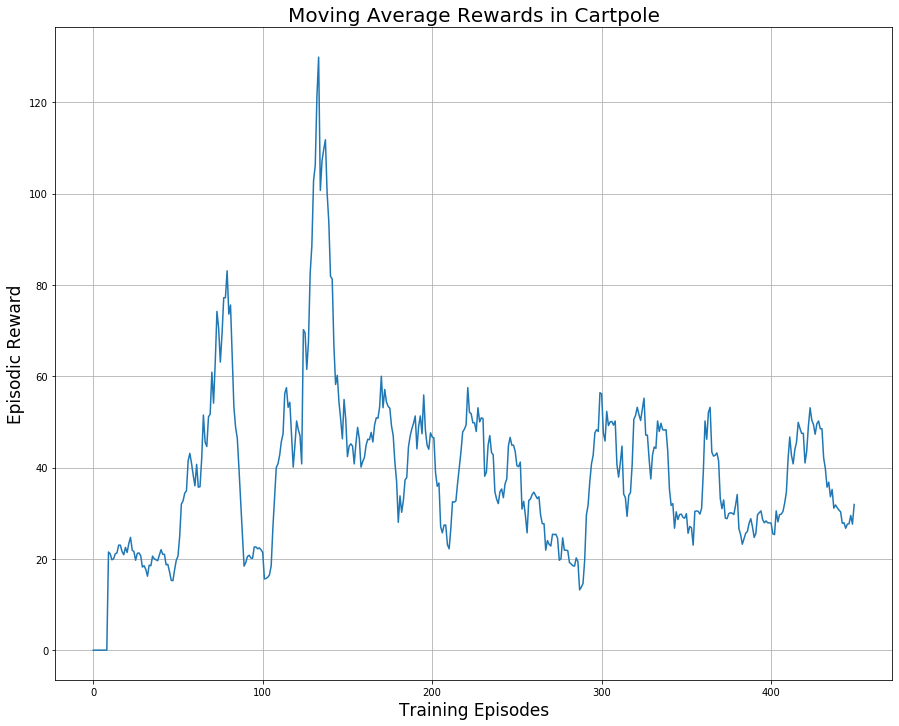

In [0]:
N = 10
# if len(durations_t) >= N:
means = durations_t.unfold(0, N, 1).mean(1).view(-1)
means = torch.cat((torch.zeros(N-1), means))   
plt.figure(figsize=[15, 12])
plt.title('Moving Average Rewards in Cartpole',fontsize=20)
plt.xlabel('Training Episodes',fontsize=17)
plt.ylabel('Episodic Reward',fontsize=17)
plt.grid(True)
plt.plot(means.numpy())
plt.savefig('./Cartpole_Moving_Average_Reward.PNG', dpi=600)
plt.show()

Animation size has reached 20974072 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


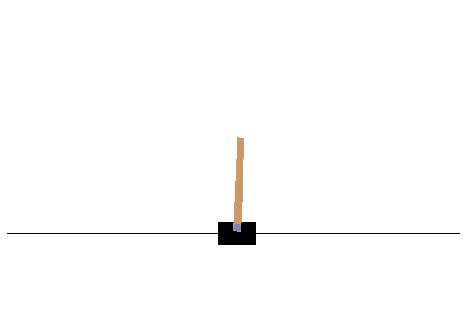

In [0]:
plt.figure(figsize=(frames[0].shape[1] / 72.0, frames[0].shape[0] / 72.0), dpi = 72)
patch = plt.imshow(frames[0])
plt.axis('off')
animate = lambda i: patch.set_data(frames[i])
ani = matplotlib.animation.FuncAnimation(plt.gcf(), animate, frames=len(frames), interval = 50)
HTML(ani.to_jshtml())